# Data Exploratory Analysis

Data exploratory analysis with pandas profiling.

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
from ydata_profiling import ProfileReport
import seaborn as sns
import matplotlib.pyplot as plt

pd.set_option('display.max_columns', None)

In [2]:
label_col = "Label"

In [3]:
raw_data = pd.read_csv("../../data/train.csv")

In [4]:
def normalize_data(data):
    mu = data[:, :].mean(axis=0)
    sigma = data[:, :].std(axis=0)
    data[:, :] = (data[:, :] - mu) / sigma
    return data

In [5]:
raw_data["year"] = raw_data['time'].apply(lambda x: int(str(x)[:4]))
raw_data["month"] = raw_data['time'].apply(lambda x: int(str(x)[4:6]))

In [6]:
data_cols = raw_data.columns
data = normalize_data(raw_data.to_numpy())
data = pd.DataFrame(data)

In [7]:
data.columns = data_cols
data['Label'] = raw_data['Label']

In [8]:
data.sort_values(by=['lat', 'lon', 'time']).iloc[35780:35790,:]

,SNo,lat,lon,TMQ,U850,V850,UBOT,VBOT,QREFHT,PS,PSL,T200,T500,PRECT,TS,TREFHT,Z1000,Z200,ZBOT,time,Label,year,month
32412,0.776443,1.096231,-0.621759,-0.045976,0.031548,0.290755,0.546275,-0.003746,-0.089882,-0.561359,-0.566550,0.169533,0.600510,-0.187061,-0.360428,-0.089889,-0.636552,0.667014,-0.038000,1.954431,0,1.956780,-0.266666
31693,0.720798,1.096231,-0.621759,1.453225,0.143573,1.884961,0.494006,1.533321,0.269833,-1.439175,-1.445894,2.090774,1.465060,-0.167664,-0.068261,0.311832,-1.606161,1.273448,0.348698,1.957302,1,1.956780,0.112977
31694,0.720875,1.096231,-0.621759,1.453225,0.143573,1.884961,0.494006,1.533321,0.269833,-1.439175,-1.445894,2.090774,1.465060,-0.167664,-0.068261,0.311832,-1.606161,1.273448,0.348698,1.957302,1,1.956780,0.112977
36170,1.067285,1.096231,-0.621759,0.032735,0.101693,-0.334794,0.887220,-1.140698,-0.222780,-1.415592,-1.422269,2.099089,1.533374,-0.187061,-0.095014,-0.199701,-1.594137,1.191915,-0.222362,1.960425,0,1.956780,0.492619
36171,1.067363,1.096231,-0.621759,0.032735,0.101693,-0.334794,0.887220,-1.140698,-0.222780,-1.415592,-1.422269,2.099089,1.533374,-0.187061,-0.095014,-0.199701,-1.594137,1.191915,-0.222362,1.960425,0,1.956780,0.492619
39203,1.302018,1.096231,-0.621759,-0.367632,0.892261,-0.782618,1.182475,-1.522567,-0.396763,-1.535358,-1.542245,2.746856,1.596338,-0.187061,-0.090295,-0.327607,-1.665561,1.300092,-0.394165,1.960456,0,1.956780,0.492619
26859,0.346681,1.096231,-0.621759,-0.220603,-0.161307,0.365840,0.174067,-0.995597,-0.081560,-0.530875,-0.536013,0.729475,0.336111,-0.174238,-0.028874,-0.007193,-0.601703,0.627448,-0.012521,1.963075,0,1.956780,0.872262
20179,-0.170303,1.096231,-0.621759,-0.073948,-0.542470,-0.728602,-0.225656,-1.348668,0.248604,-0.401670,-0.406582,0.145493,0.719143,-0.187061,0.013644,-0.011161,-0.457021,0.550462,0.018696,1.963359,0,1.956780,0.872262
21954,-0.032931,1.096231,-0.621759,-1.748779,0.005026,0.270824,-0.120183,-1.320933,-0.992767,-0.167616,-0.172121,0.406283,0.943833,-0.187061,-1.193833,-1.468657,-0.266798,0.526288,-1.435305,2.265890,0,2.272335,-0.646309
31436,0.700908,1.096231,-0.621759,-1.348780,0.153038,-0.392731,0.474103,-0.775916,-0.972972,-0.682689,-0.688091,-0.690645,1.185557,-0.187061,-0.997163,-1.111337,-0.811853,0.265249,-1.089341,2.266300,0,2.272335,-0.646309


In [9]:
data.describe()

,SNo,lat,lon,TMQ,U850,V850,UBOT,VBOT,QREFHT,PS,PSL,T200,T500,PRECT,TS,TREFHT,Z1000,Z200,ZBOT,time,Label,year,month
count,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,4.476000e+04,44760.000000,4.476000e+04,4.476000e+04
mean,-4.063873e-17,-3.047904e-17,4.876647e-16,-2.158932e-16,8.127745e-17,1.269960e-17,1.219162e-16,-2.412924e-17,-3.454292e-16,-3.043841e-14,-4.063873e-15,-6.356151e-16,1.493473e-15,-4.825849e-17,7.497845e-15,1.102833e-14,-3.962276e-16,3.505090e-15,-5.338913e-15,4.405492e-15,0.387332,-4.254367e-15,-1.015968e-17
std,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,1.000011e+00,0.764119,1.000011e+00,1.000011e+00
min,-1.732012e+00,-1.229417e+00,-9.795882e-01,-2.166824e+00,-8.475495e+00,-6.082812e+00,-9.262360e+00,-4.168152e+00,-2.534085e+00,-9.074468e+00,-9.094477e+00,-3.486818e+00,-4.392066e+00,-1.870608e-01,-2.395259e+00,-2.875067e+00,-1.704305e+00,-4.422474e+00,-2.848986e+00,-1.834936e+00,0.000000,-1.829881e+00,-2.544522e+00
25%,-8.660061e-01,-9.451146e-01,-6.674396e-01,-8.394000e-01,-7.151643e-01,-5.485009e-01,-7.310329e-01,-6.454440e-01,-7.883670e-01,-7.202157e-01,-7.191051e-01,-5.947975e-01,-4.010507e-01,-1.870608e-01,-6.338771e-01,-6.550342e-01,-7.745312e-01,-4.619589e-01,-6.875198e-01,-5.637063e-01,0.000000,-5.676608e-01,-6.463085e-01
50%,0.000000e+00,-4.098058e-02,-3.933579e-01,1.233960e-02,-1.598908e-01,3.851626e-02,-9.282380e-02,-9.965641e-03,6.021179e-02,-4.624256e-02,-4.463063e-02,1.220714e-01,2.373905e-01,-1.657854e-01,1.083780e-01,1.073119e-01,-4.015308e-02,2.297841e-01,9.498527e-02,-2.474841e-01,0.000000,-2.521057e-01,1.129768e-01
75%,8.660061e-01,1.078302e+00,1.928723e-01,7.597686e-01,6.052772e-01,5.441650e-01,6.275021e-01,5.938868e-01,9.045846e-01,5.869332e-01,5.861555e-01,6.700698e-01,7.090745e-01,-6.332825e-02,9.094750e-01,8.885693e-01,6.148267e-01,7.578201e-01,9.123607e-01,3.767268e-01,0.000000,3.790045e-01,8.722620e-01
max,1.732012e+00,1.178192e+00,2.073377e+00,3.604887e+00,4.789638e+00,1.348395e+01,5.339756e+00,6.667036e+00,2.022631e+00,4.486260e+00,4.489856e+00,5.376551e+00,2.663847e+00,5.861654e+01,1.468198e+00,1.860701e+00,4.547289e+00,1.586657e+00,1.686848e+00,2.279139e+00,2.000000,2.272335e+00,1.631547e+00


In [10]:
data.Label.value_counts(normalize=True)

0    0.785947
2    0.173280
1    0.040773
Name: Label, dtype: float64

In [10]:
profile = ProfileReport(data.drop("SNo", axis=1), title="Profiling Report")

In [11]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

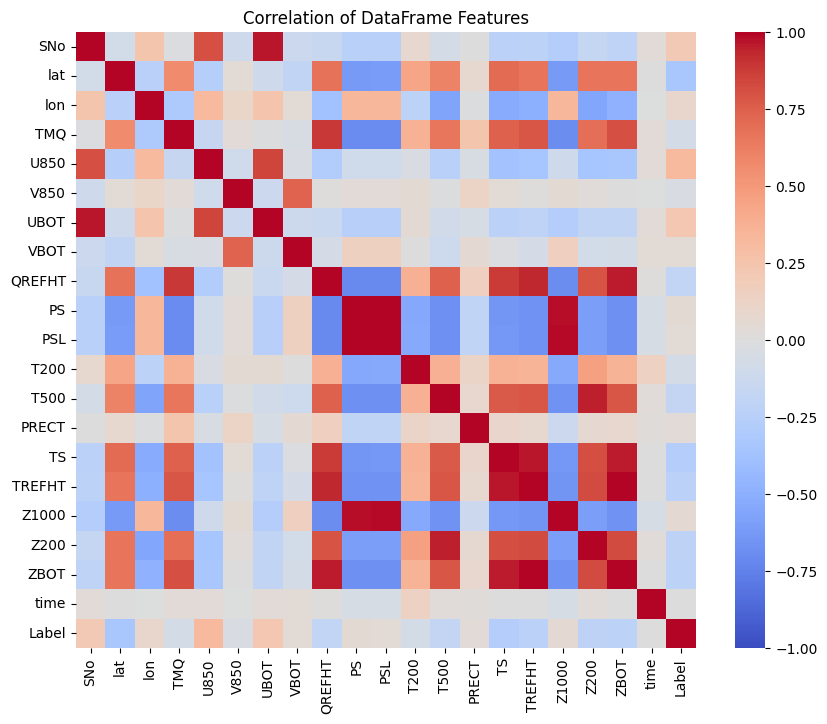

In [5]:
# Compute correlation matrix
corr_matrix = data.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation of DataFrame Features')
plt.show()

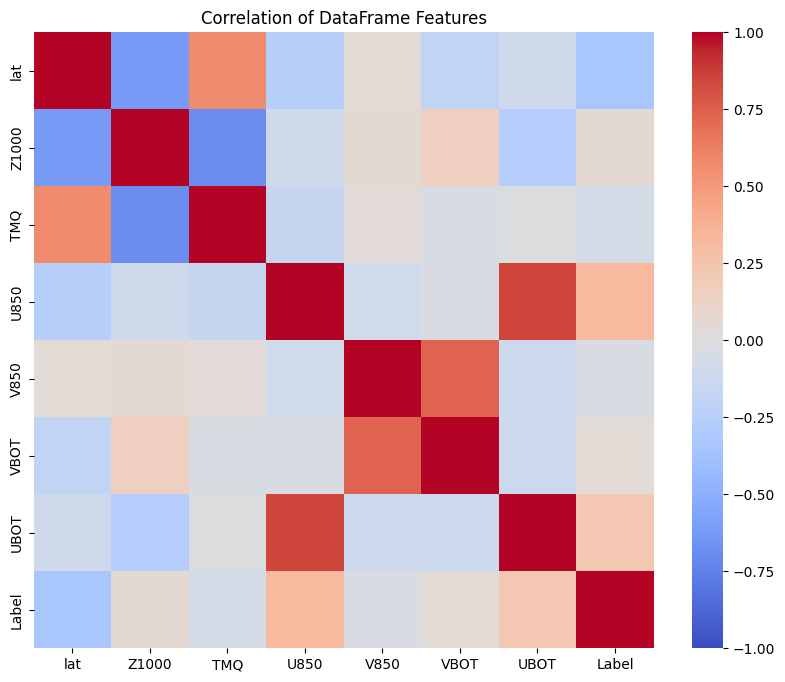

In [47]:
data_sel = data.drop(['SNo', "PSL", "TS", "TREFHT", "Z1000", "ZBOT", "TMQ", "Z200", "UBOT", "QREFHT"], axis=1)
# Compute correlation matrix
corr_matrix = data[["lat",
    "Z1000",
    "TMQ",
    "U850",
    "V850",
    "VBOT",
    "UBOT",
    "Label"]].corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation of DataFrame Features')
plt.show()

IndexError: index 5 is out of bounds for axis 0 with size 5

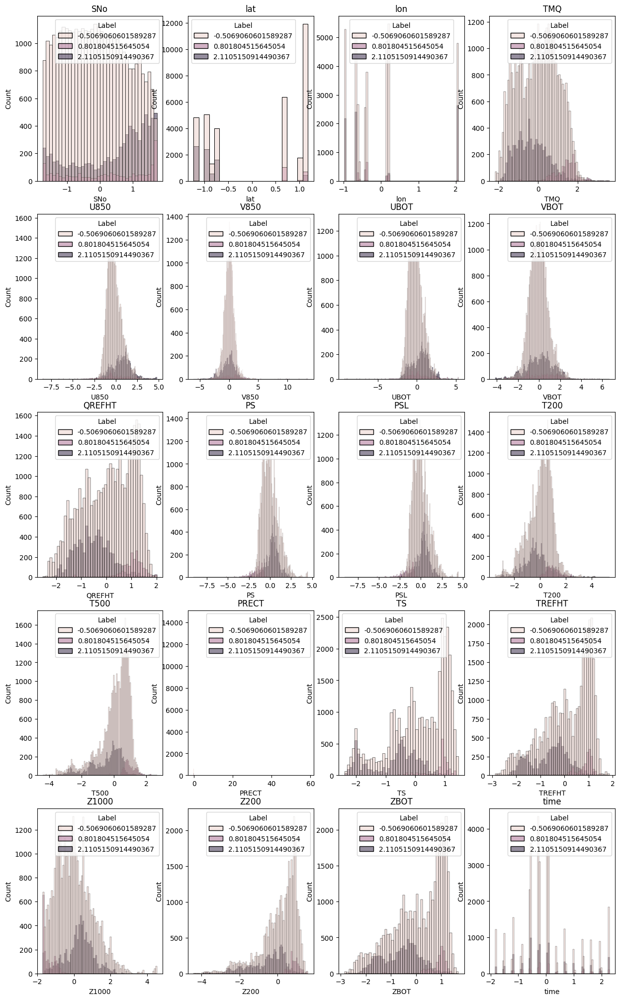

In [75]:
n_cols = 4
n_rows = 5
fig, ax = plt.subplots(n_rows, n_cols, figsize=(15, 25))

for i, column in enumerate(data.columns):
    row = i // n_cols
    col = i % n_cols
    sns.histplot(data=data, x=column,  ax=ax[row, col], hue="Label")
    ax[row, col].set_title(column)

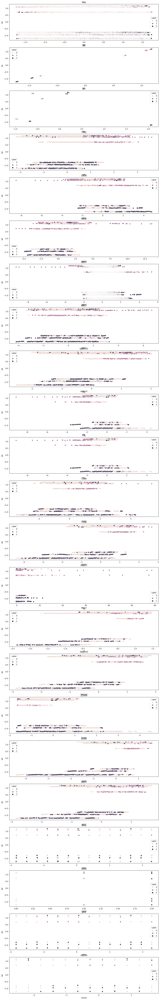

In [17]:
colno = len(data.columns)
# grs = colno * (colno - 1)
fig, ax = plt.subplots(colno, figsize=(15, 100))

for i, col1 in enumerate(data.columns):
    # for col2 in data.columns:
    sns.scatterplot(data=data, x=col1, y="lat", hue="Label", ax=ax[i]).set_title(col1)

<Axes: xlabel='lon', ylabel='lat'>

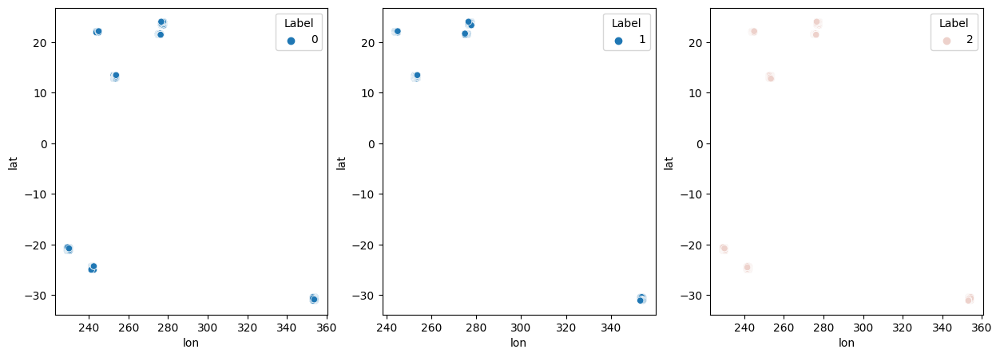

In [33]:
fig, ax = plt.subplots(ncols=3, nrows=1, figsize=(15, 5))
sns.scatterplot(data=data[data["Label"] == 0], x="lon", y="lat", hue="Label", ax=ax[0])
sns.scatterplot(data=data[data["Label"] == 1], x="lon", y="lat", hue="Label", ax=ax[1])
sns.scatterplot(data=data[data["Label"] == 2], x="lon", y="lat", hue="Label", ax=ax[2])

In [38]:
def cart2pol(x, y):
    rho = np.sqrt(x**2 + y**2)
    phi = np.arctan2(y, x)
    return(rho, phi)

def pol2cart(rho, phi):
    x = rho * np.cos(phi)
    y = rho * np.sin(phi)
    return(x, y)

/var/folders/hw/4hw4rbpn1h3fl_fsrpw80hd80000gn/T/ipykernel_96698/1969771263.py:4: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  c = ax.scatter(theta, r,  cmap='hsv', alpha=0.75)


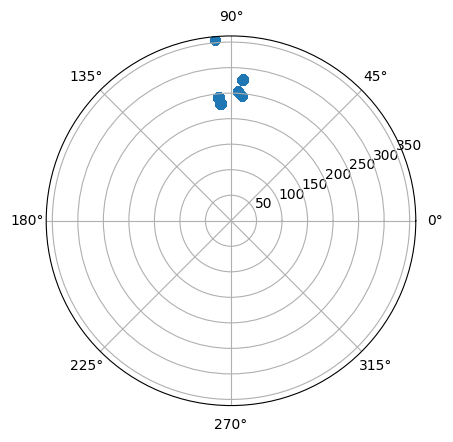

In [58]:
r, theta = cart2pol(data['lat'], data['lon'])
fig = plt.figure()
ax = fig.add_subplot(projection='polar')
c = ax.scatter(theta, r,  cmap='hsv', alpha=0.75)

<Axes: xlabel='lat', ylabel='Count'>

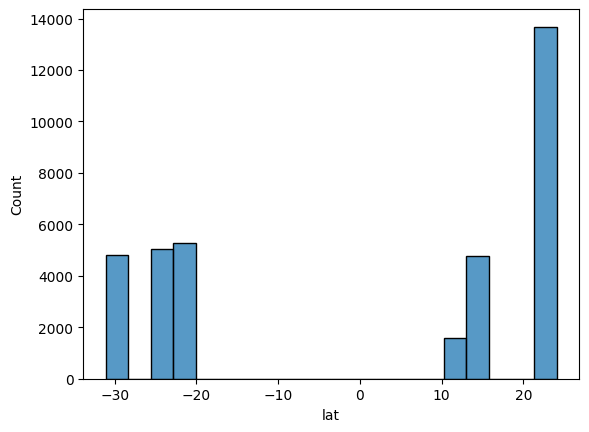

In [63]:
l = 0
sns.histplot(data[data["Label"] == l]["lat"] )

<Axes: xlabel='lat', ylabel='Count'>

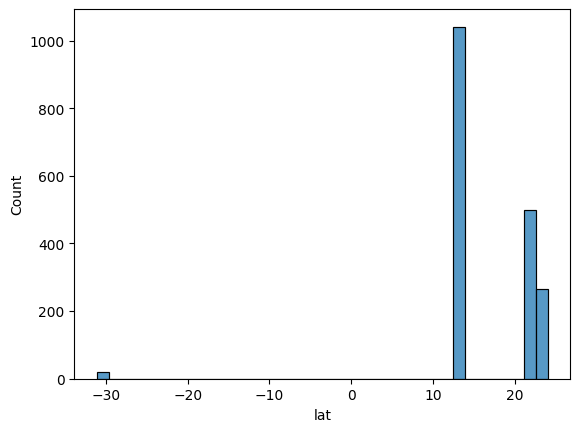

In [65]:
l = 1
sns.histplot(data[data["Label"] == l]["lat"] )

<Axes: xlabel='lat', ylabel='Count'>

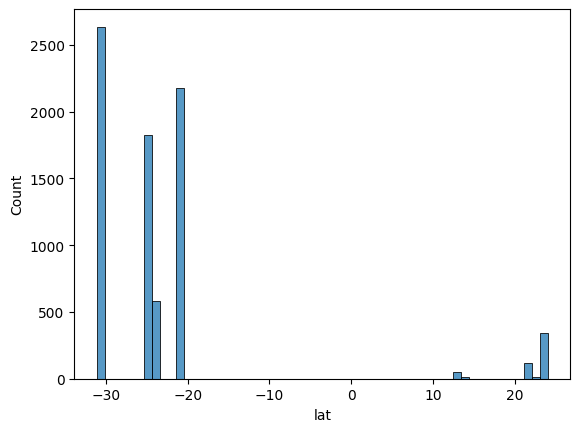

In [66]:
l = 2
sns.histplot(data[data["Label"] == l]["lat"] )

In [67]:
data.columns

Index(['SNo', 'lat', 'lon', 'TMQ', 'U850', 'V850', 'UBOT', 'VBOT', 'QREFHT',
       'PS', 'PSL', 'T200', 'T500', 'PRECT', 'TS', 'TREFHT', 'Z1000', 'Z200',
       'ZBOT', 'time', 'Label', 'abs_lat'],
      dtype='object')

<Axes: xlabel='U850', ylabel='Count'>

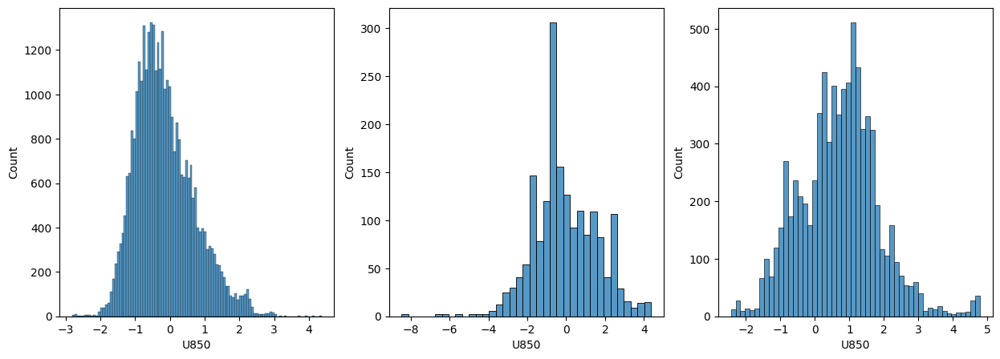

In [95]:
l = 0
df_tmp = data.copy()
new_col = "U850"

fig, ax = plt.subplots(ncols=3, nrows=1, figsize=(15, 5))
sns.histplot(data=df_tmp[df_tmp["Label"] == 0][new_col], ax=ax[0])
sns.histplot(data=df_tmp[df_tmp["Label"] == 1][new_col], ax=ax[1])
sns.histplot(data=df_tmp[df_tmp["Label"] == 2][new_col], ax=ax[2])

In [78]:
data.columns

Index(['SNo', 'lat', 'lon', 'TMQ', 'U850', 'V850', 'UBOT', 'VBOT', 'QREFHT',
       'PS', 'PSL', 'T200', 'T500', 'PRECT', 'TS', 'TREFHT', 'Z1000', 'Z200',
       'ZBOT', 'time', 'Label', 'abs_lat'],
      dtype='object')

<Axes: xlabel='T_diff', ylabel='Count'>

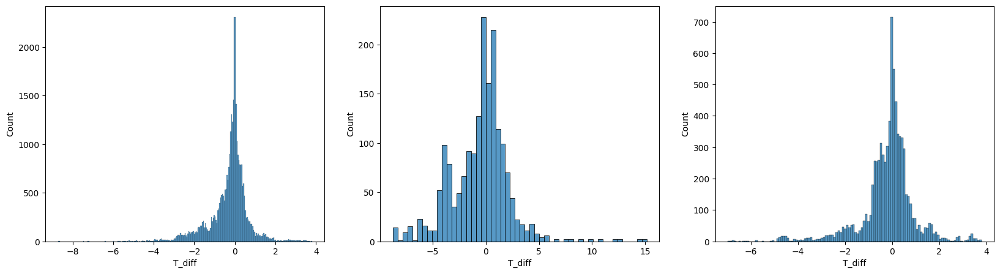

In [93]:
l = 0
df_tmp = data.copy()
col1 = "UBOT"
col2 = "Z1000"
col3 = "VBOT"
new_col = "T_diff"
df_tmp[new_col] = (df_tmp[col2] * df_tmp[col1])
fig, ax = plt.subplots(ncols=3, nrows=1, figsize=(20, 5))
sns.histplot(data=df_tmp[df_tmp["Label"] == 0][new_col], ax=ax[0])
sns.histplot(data=df_tmp[df_tmp["Label"] == 1][new_col], ax=ax[1])
sns.histplot(data=df_tmp[df_tmp["Label"] == 2][new_col], ax=ax[2])

In [ ]:
col2

Confusion Matrix:
[[10283     7  1339]
 [  553    18     7]
 [ 1691     0   873]] 

Accuracy:
0.7565 

Precision:
0.6448 

Recall:
0.4186
